# EfficientDet Tutorial: inference, eval, and training 



In [1]:
import os
import sys
import tensorflow.compat.v1 as tf

In [2]:

#!git clone --depth 1 https://github.com/google/automl

In [3]:
os.chdir('automl/efficientdet')

In [4]:
#!pip install -r requirements.txt

In [5]:
#!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
#!pip install pycocotools

In [6]:
import wget
import tarfile

MODEL = 'efficientdet-d0'

def download(m):
    if m not in os.listdir():
        #wget.download('https://storage.googleapis.com/cloud-tpu-checkpoints/efficientdet/coco2/{m}.tar.gz')
        wget.download('https://storage.googleapis.com/cloud-tpu-checkpoints/efficientdet/coco2/efficientdet-d0.tar.gz')
        file = tarfile.open('efficientdet-d0.tar.gz')
        file.extractall('./efficientdet-d0')
        #!tar zxf {m}.tar.gz
    ckpt_path = os.path.join(os.getcwd(), MODEL)
    return ckpt_path


In [7]:
# Download checkpoint.
ckpt_path = download(MODEL)
print('Use model in {}'.format(ckpt_path))

Use model in D:\1-pipelined_topics\efficientdet\demo_efficientdet\automl\efficientdet\efficientdet-d0


In [11]:
!python model_inspect.py --model_name={MODEL} --logdir=logs
%load_ext tensorboard
%tensorboard --logdir logs

2021-09-14 17:08:31.174567: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cudart64_110.dll'; dlerror: cudart64_110.dll not found
2021-09-14 17:08:31.174601: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2021-09-14 17:08:33.469683: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cudart64_110.dll'; dlerror: cudart64_110.dll not found
2021-09-14 17:08:33.470721: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cublas64_11.dll'; dlerror: cublas64_11.dll not found
2021-09-14 17:08:33.471900: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cublasLt64_11.dll'; dlerror: cublasLt64_11.dll not found
2021-09-14 17:08:33.476075: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cu

Reusing TensorBoard on port 6006 (pid 13208), started 3:14:58 ago. (Use '!kill 13208' to kill it.)

In [14]:
m = 'efficientdet-d0'  
batch_size = 1 
m_path = download(m)

#Exporting the saved model
saved_model_dir = 'savedmodel'

!python model_inspect.py --runmode=saved_model --model_name={m} --ckpt_path={m_path} --saved_model_dir={saved_model_dir} \
  --batch_size={batch_size}  --hparams="mixed_precision=true"


2021-09-14 14:49:51.584591: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cudart64_110.dll'; dlerror: cudart64_110.dll not found
2021-09-14 14:49:51.584627: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2021-09-14 14:49:53.604964: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cudart64_110.dll'; dlerror: cudart64_110.dll not found
2021-09-14 14:49:53.606002: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cublas64_11.dll'; dlerror: cublas64_11.dll not found
2021-09-14 14:49:53.607054: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cublasLt64_11.dll'; dlerror: cublasLt64_11.dll not found
2021-09-14 14:49:53.614670: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cu

## Inference images



#### 1.  export a saved model.

##### 2. Then run saved_model_infer to do inference.

In [15]:
#  Exported the saved model in above cell.

# Then run saved_model_infer to do inference.
# Notably: batch_size, image_size must be the same as when it is exported.
serve_image_out = 'serve_image_out'
!mkdir {serve_image_out}

!python model_inspect.py --runmode=saved_model_infer --saved_model_dir={saved_model_dir} --model_name={MODEL} \
--input_image=testdata/img1.jpg --output_image_dir={serve_image_out} \
  --min_score_thresh={min_score_thresh}  --max_boxes_to_draw={max_boxes_to_draw}

all_files= ['testdata\\img1.jpg']
writing file to serve_image_out\0.jpg


2021-09-14 14:50:28.222379: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cudart64_110.dll'; dlerror: cudart64_110.dll not found
2021-09-14 14:50:28.222414: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2021-09-14 14:50:30.272071: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cudart64_110.dll'; dlerror: cudart64_110.dll not found
2021-09-14 14:50:30.273030: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cublas64_11.dll'; dlerror: cublas64_11.dll not found
2021-09-14 14:50:30.274066: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cublasLt64_11.dll'; dlerror: cublasLt64_11.dll not found
2021-09-14 14:50:30.278061: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cu

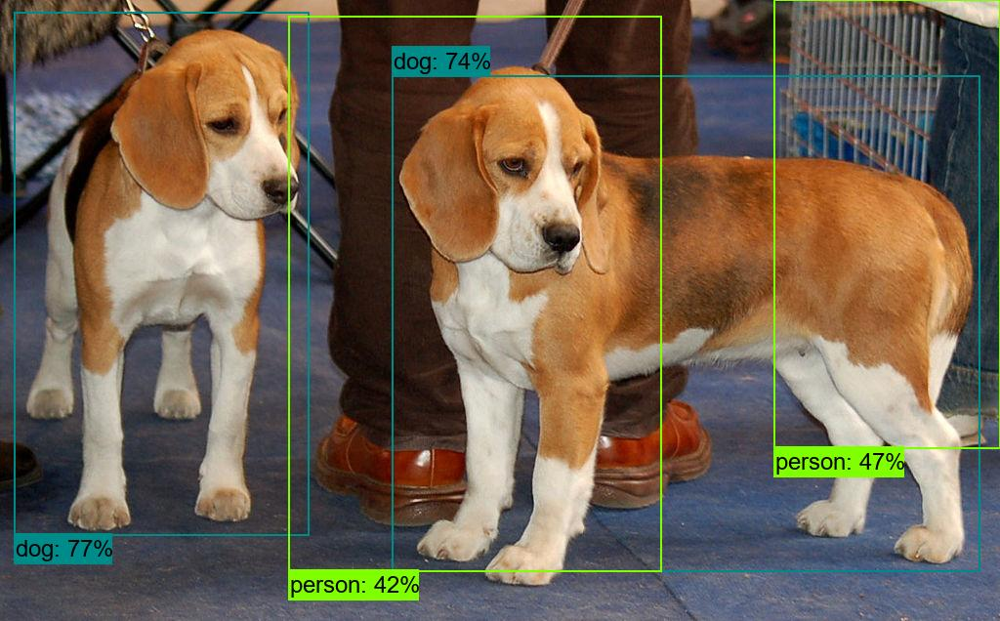

In [16]:
from IPython import display
display.display(display.Image(os.path.join(serve_image_out, '0.jpg')))

In [17]:
import cv2


video_url = 'https://storage.googleapis.com/cloud-tpu-checkpoints/efficientdet/data/video480p.mov' 
wget.download(video_url)

oldname = 'video480p.mov'
newname = 'input.mov'

os.rename(oldname, newname)


# Step 2: do inference with saved model using saved_model_video
!python model_inspect.py --runmode=saved_model_video --model_name=efficientdet-d0 --ckpt_path=efficientdet-d0 \
--saved_model_dir={saved_model_dir} --hparams="mixed_precision=true" --input_video=input.mov --output_video=output.mov

 20% [..............                                                          ]  3751936 / 18511760

 40% [.............................                                           ]  7471104 / 18511760

 45% [................................                                        ]  8388608 / 18511760

 68% [.................................................                       ] 12705792 / 18511760

 86% [..............................................................          ] 15958016 / 18511760

 90% [.................................................................       ] 16777216 / 18511760

100% [........................................................................] 18511760 / 18511760

2021-09-14 14:51:00.140320: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cudart64_110.dll'; dlerror: cudart64_110.dll not found
2021-09-14 14:51:00.140354: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.
2021-09-14 14:51:02.241416: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cudart64_110.dll'; dlerror: cudart64_110.dll not found
2021-09-14 14:51:02.242395: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cublas64_11.dll'; dlerror: cublas64_11.dll not found
2021-09-14 14:51:02.243342: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cublasLt64_11.dll'; dlerror: cublasLt64_11.dll not found
2021-09-14 14:51:02.247374: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'cu

In [38]:
from IPython.display import display, HTML 
from base64 import b64encode

def display_video(path):  
    mp4 = open(path,'rb').read()   
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    display(
      HTML(
      """
          <video width=700 height=500 controls>
                <source src="%s" type="video/mp4">
          </video>
      """ % data_url
           )   
    )
display_video("output.mp4")